In [1]:
import json
import os
from pathlib import Path

import cv2
import matplotlib.pyplot as plt
import numpy as np
import requests
import torch
import yaml
from PIL import Image
from tqdm import tqdm
from ultralytics import YOLO
import shutil

In [1]:
import os
import shutil
import json
import yaml
from pathlib import Path
from tqdm import tqdm
from PIL import Image
import requests


def make_dirs(dir="new_dir/"):
    """Creates a directory with subdirectories 'labels' and 'images', removing existing ones."""
    dir = Path(dir)
    if dir.exists():
        shutil.rmtree(dir)  # delete dir
    for p in dir, dir / "labels", dir / "images":
        p.mkdir(parents=True, exist_ok=True)  # make dir
    return dir


def convert(file, zip=True):
    """Converts Labelbox NDJSON labels to YOLO format and saves them, with optional zipping."""
    names = []  # class names
    file = Path(file)
    save_dir = make_dirs(f"/media/avalocal/T9/harsha/datasets/{file.stem}")
    with open(file) as f:
        lines = f.readlines()  # Read the file line by line

    data = [json.loads(line) for line in lines]  # Parse each line as JSON

    for img in tqdm(data, desc=f"Converting {file}"):
        # print(img)
        data = img["data_row"]
        im_path = data["row_data"]
        im = Image.open(
            requests.get(im_path, stream=True).raw
            if im_path.startswith("http")
            else im_path
        )  # open
        width, height = im.size  # image size
        label_path = (
            save_dir / "labels" / Path(data["external_id"]).with_suffix(".txt").name
        )
        image_path = save_dir / "images" / data["external_id"]
        im.save(image_path, quality=95, subsampling=0)

        # print(img['projects']['clwb1ya3l00w307z746dy5uh6']['labels'])

        # for label in img["Label"]["objects"]:
        for label in img["projects"]["clwb1ya3l00w307z746dy5uh6"]["labels"]:
            # box
            # print(label)
            # top, left, h, w = label["bbox"].values()  # top, left, height, width
            for key in label["annotations"]["objects"]:
                top, left, h, w = key[
                    "bounding_box"
                ].values()  # top, left, height, width
                xywh = [
                    (left + w / 2) / width,
                    (top + h / 2) / height,
                    w / width,
                    h / height,
                ]  # xywh normalized

                # class
                cls = key["value"]  # class name
                if cls not in names:
                    names.append(cls)

                line = names.index(cls), *xywh  # YOLO format (class_index, xywh)
                with open(label_path, "a") as f:
                    f.write(("%g " * len(line)).rstrip() % line + "\n")

    # Save dataset.yaml
    d = {
        "path": f"../datasets/{file.stem}",  # dataset root dir
        "train": "images/train",  # train images (relative to path) 128 images
        "val": "images/val",  # val images (relative to path) 128 images
        "test": "",  # test images (optional)
        "nc": len(names),
        "names": names,
    }  # dictionary

    with open(save_dir / file.with_suffix(".yaml").name, "w") as f:
        yaml.dump(d, f, sort_keys=False)

    # Zip
    if zip:
        print(f"Zipping as {save_dir}.zip...")
        shutil.make_archive(save_dir, "zip", save_dir)

    print("Conversion completed successfully!")


if __name__ == "__main__":
    convert("/media/avalocal/T9/harsha/LabelBox_Data/Labelbox_Speedlimit.ndjson")

Converting /media/avalocal/T9/harsha/LabelBox_Data/Labelbox_Speedlimit.ndjson: 100%|██████████| 1159/1159 [03:31<00:00,  5.49it/s]


Zipping as /media/avalocal/T9/harsha/datasets/Labelbox_Speedlimit.zip...
Conversion completed successfully!


In [12]:
import os

# counting the number of occurences of each class in the dataset
# Define the class names dictionary
class_names = {
    0: "person",
    1: "bicycle",
    2: "car",
    3: "motorcycle",
    4: "airplane",
    5: "bus",
    6: "train",
    7: "truck",
    8: "boat",
    9: "traffic light",
    10: "fire hydrant",
    11: "stop sign",
    12: "parking meter",
    13: "bench",
    14: "bird",
    15: "cat",
    16: "dog",
    17: "horse",
    18: "sheep",
    19: "cow",
    20: "elephant",
    21: "bear",
    22: "zebra",
    23: "giraffe",
    24: "backpack",
    25: "umbrella",
    26: "handbag",
    27: "tie",
    28: "suitcase",
    29: "frisbee",
    30: "skis",
    31: "snowboard",
    32: "sports ball",
    33: "kite",
    34: "baseball bat",
    35: "baseball glove",
    36: "skateboard",
    37: "surfboard",
    38: "tennis racket",
    39: "bottle",
    40: "wine glass",
    41: "cup",
    42: "fork",
    43: "knife",
    44: "spoon",
    45: "bowl",
    46: "banana",
    47: "apple",
    48: "sandwich",
    49: "orange",
    50: "broccoli",
    51: "carrot",
    52: "hot dog",
    53: "pizza",
    54: "donut",
    55: "cake",
    56: "chair",
    57: "couch",
    58: "potted plant",
    59: "bed",
    60: "dining table",
    61: "toilet",
    62: "tv",
    63: "laptop",
    64: "mouse",
    65: "remote",
    66: "keyboard",
    67: "cell phone",
    68: "microwave",
    69: "oven",
    70: "toaster",
    71: "sink",
    72: "refrigerator",
    73: "book",
    74: "clock",
    75: "vase",
    76: "scissors",
    77: "teddy bear",
    78: "hair drier",
    79: "toothbrush",
}

# Initialize a dictionary to count occurrences of each class ID
class_counts = {class_id: 0 for class_id in class_names.keys()}

# Path to the folder containing the txt files
folder_path = "/media/avalocal/T9/harsha/datasets/coco_mini/labels/train"

# Iterate through all files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(".txt"):
        file_path = os.path.join(folder_path, filename)
        with open(file_path, "r") as file:
            lines = file.readlines()
            for line in lines:
                class_id = int(line.split()[0])
                if class_id in class_counts:
                    class_counts[class_id] += 1

# Print the number of occurrences of each class
for class_id, count in class_counts.items():
    class_name = class_names[class_id]
    print(f"{class_name}: {count}")

person: 55464
bicycle: 1479
car: 9421
motorcycle: 1940
airplane: 1052
bus: 1248
train: 1095
truck: 2132
boat: 2523
traffic light: 2842
fire hydrant: 412
stop sign: 423
parking meter: 313
bench: 2170
bird: 2217
cat: 1032
dog: 1166
horse: 1380
sheep: 1919
cow: 1761
elephant: 1125
bear: 270
zebra: 1100
giraffe: 1072
backpack: 1851
umbrella: 2362
handbag: 2678
tie: 1438
suitcase: 1352
frisbee: 596
skis: 1399
snowboard: 558
sports ball: 1409
kite: 1743
baseball bat: 736
baseball glove: 840
skateboard: 1093
surfboard: 1343
tennis racket: 1054
bottle: 5115
wine glass: 1689
cup: 4234
fork: 1219
knife: 1544
spoon: 1308
bowl: 3125
banana: 2006
apple: 1232
sandwich: 989
orange: 1356
broccoli: 1412
carrot: 1544
hot dog: 562
pizza: 1108
donut: 1549
cake: 1416
chair: 7845
couch: 1252
potted plant: 1926
bed: 924
dining table: 3309
toilet: 895
tv: 1159
laptop: 1052
mouse: 459
remote: 1193
keyboard: 632
cell phone: 1352
microwave: 345
oven: 671
toaster: 43
sink: 1248
refrigerator: 549
book: 5100
clock:

In [2]:
# Script to remove the txt files in a folder if they are empty

# Path to the directory containing the txt files
directory_path = "/media/avalocal/T9/harsha/cones_final/labels"

# Loop through all files in the directory
for filename in os.listdir(directory_path):
    # Construct full file path
    file_path = os.path.join(directory_path, filename)

    # Check if the file is a txt file and if it is empty
    if (
        filename.endswith(".txt")
        and os.path.isfile(file_path)
        and os.path.getsize(file_path) == 0
    ):
        # If the file is empty, remove it
        os.remove(file_path)
        print(f"Removed empty file: {filename}")

In [ ]:
# change class ids in the custom dataset


def change_class_ids_in_file(file_path, class_mapping):
    with open(file_path, "r+") as file:
        lines = file.readlines()
        for i, line in enumerate(lines):
            parts = line.split()
            if len(parts) > 0:
                old_class_id = int(parts[0])
                if old_class_id in class_mapping:
                    parts[0] = str(class_mapping[old_class_id])
                    lines[i] = " ".join(parts) + "\n"
        file.seek(0)
        file.truncate()
        file.writelines(lines)


def change_class_ids_in_directory(directory_path, class_mapping):
    for root, _, files in os.walk(directory_path):
        for file_name in files:
            if file_name.endswith(".txt"):
                file_path = os.path.join(root, file_name)
                change_class_ids_in_file(file_path, class_mapping)


# Class mapping from old IDs to new IDs
class_mapping = {
    80: 81,
    81: 82,
    82: 83,
    83: 84,
    84: 85,
    85: 86,
    86: 87,
    87: 88,
    88: 89,
    89: 90,
}

# Directories to change class IDs in
directories = [
    "/media/avalocal/T9/harsha/datasets/speed_limit_data_all_labels_mini/val/labels"
]

# Change class IDs in each directory
for directory in directories:
    change_class_ids_in_directory(directory, class_mapping)

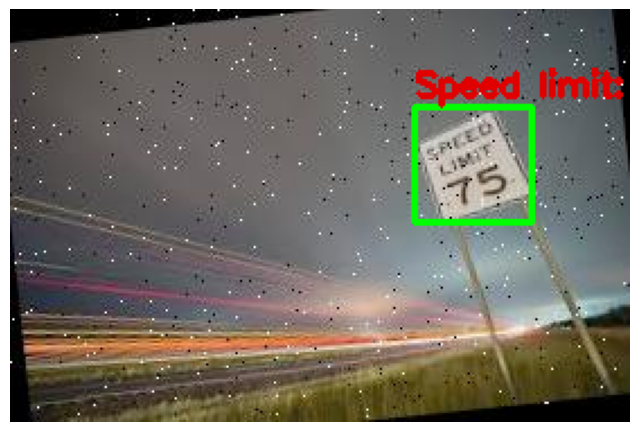

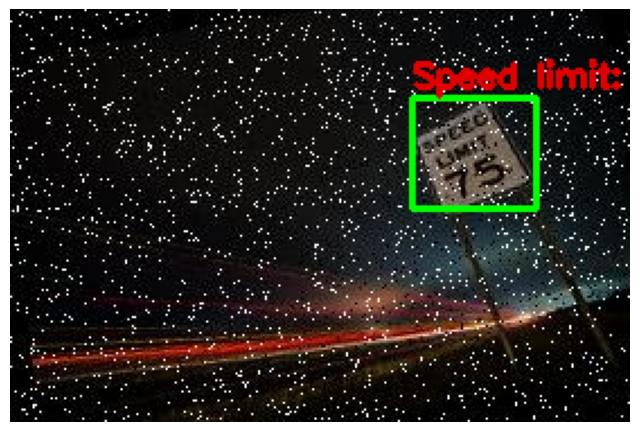

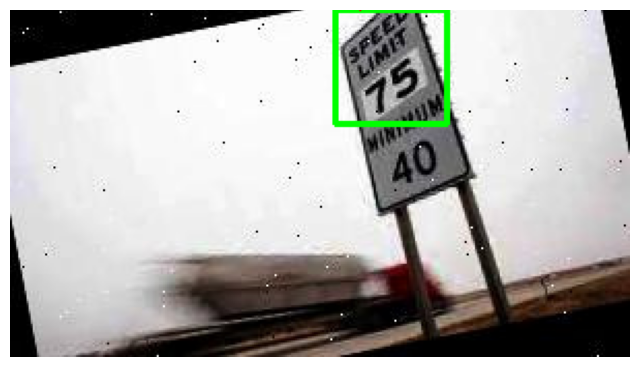

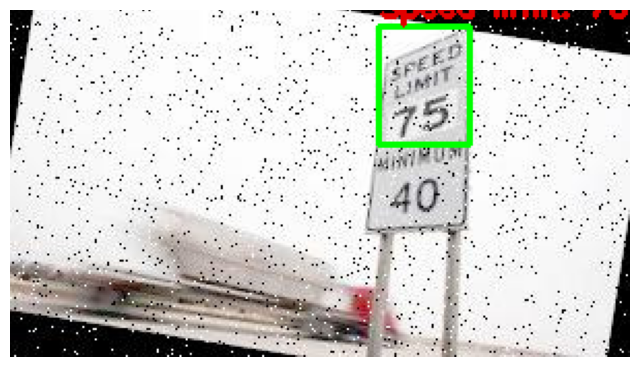

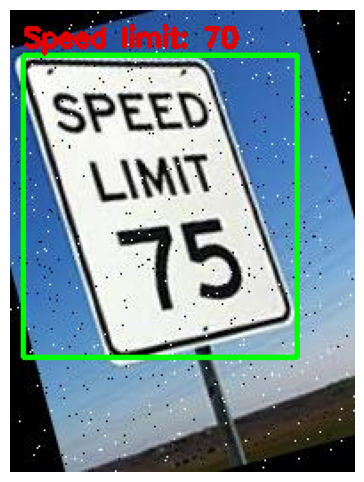

...

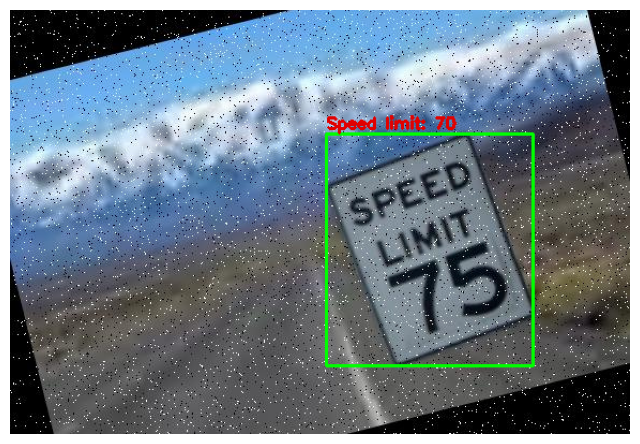

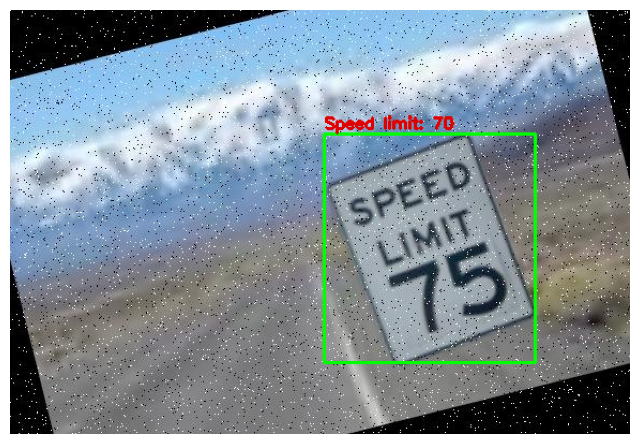

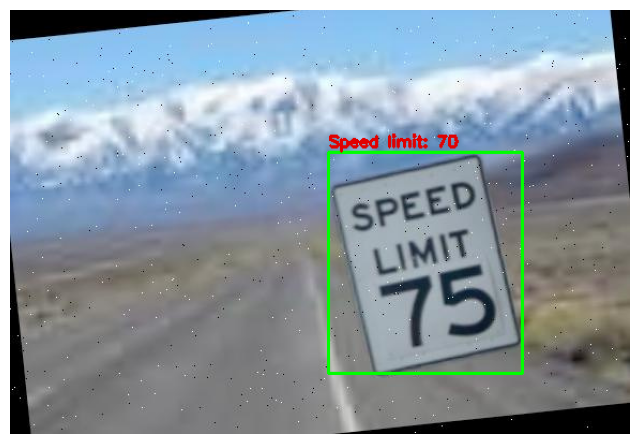

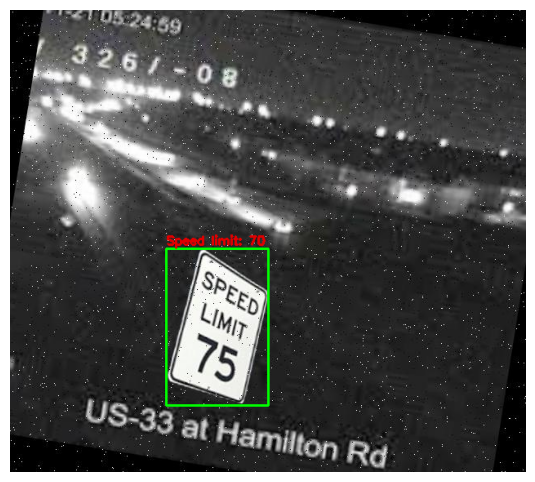

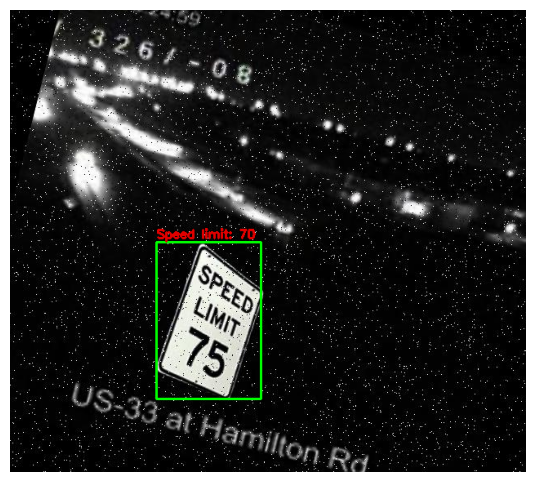

In [17]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import yaml
%matplotlib inline

def load_image(image_path):
    """Load an image from the specified path."""
    return cv2.imread(image_path)

def load_labels(label_file):
    """Load bounding box labels from a text file."""
    try:
        with open(label_file, "r") as file:
            lines = file.readlines()
        bboxes = []
        for line in lines:
            values = line.strip().split()
            box = [float(i) for i in values]
            bboxes.append(box)
        return bboxes
    except FileNotFoundError:
        print('Label file not found:', label_file)
        return []

def draw_bounding_boxes(image, bboxes, class_names):
    """Draw bounding boxes with labels on the image."""
    for bbox in bboxes:
        class_id, x_center, y_center, width, height = bbox
        image_height, image_width, _ = image.shape
        x_min = int((x_center - width / 2) * image_width)
        y_min = int((y_center - height / 2) * image_height)
        box_width = int(width * image_width)
        box_height = int(height * image_height)
        color = (0, 255, 0)  # Green color for bounding boxes

        cv2.rectangle(image, (x_min, y_min), (x_min + box_width, y_min + box_height), color , 2)

        if class_id in class_names:
            class_name = class_names[class_id]
            label = f"{class_name}"
            font = cv2.FONT_HERSHEY_SIMPLEX
            font_scale = 0.5
            font_thickness = 2
            text_size = cv2.getTextSize(label, font, font_scale, font_thickness)[0]
            cv2.putText(image, label, (x_min, y_min - 5), font, font_scale, (0, 0, 225), font_thickness)

def main():
    class_names = {
    0: 'person',
   1: 'bicycle',
   2: 'car',
   3: 'motorcycle',
   4: 'airplane',
   5: 'bus',
   6: 'train',
   7: 'truck',
   8: 'boat',
   9: 'traffic light',
   10: 'fire hydrant',
   11: 'stop sign',
   12: 'parking meter',
   13: 'bench',
   14: 'bird',
   15: 'cat',
   16: 'dog',
   17: 'horse',
   18: 'sheep',
   19: 'cow',
   20: 'elephant',
   21: 'bear',
   22: 'zebra',
   23: 'giraffe',
   24: 'backpack',
   25: 'umbrella',
   26: 'handbag',
   27: 'tie',
   28: 'suitcase',
   29: 'frisbee',
   30: 'skis',
   31: 'snowboard',
   32: 'sports ball',
   33: 'kite',
   34: 'baseball bat',
   35: 'baseball glove',
   36: 'skateboard',
   37: 'surfboard',
   38: 'tennis racket',
   39: 'bottle',
   40: 'wine glass',
   41: 'cup',
   42: 'fork',
   43: 'knife',
   44: 'spoon',
   45: 'bowl',
   46: 'banana',
   47: 'apple',
   48: 'sandwich',
   49: 'orange',
   50: 'broccoli',
   51: 'carrot',
   52: 'hot dog',
   53: 'pizza',
   54: 'donut',
   55: 'cake',
   56: 'chair',
   57: 'couch',
   58: 'potted plant',
   59: 'bed',
   60: 'dining table',
   61: 'toilet',
   62: 'tv',
   63: 'laptop',
   64: 'mouse',
   65: 'remote',
   66: 'keyboard',
   67: 'cell phone',
   68: 'microwave',
   69: 'oven',
   70: 'toaster',
   71: 'sink',
   72: 'refrigerator',
   73: 'book',
   74: 'clock',
   75: 'vase',
   76: 'scissors',
   77: 'teddy bear',
   78: 'hair drier',
   79: 'toothbrush',
   80: 'cone',
   81: "Speed limit: 70",
    82: "Speed limit: 75",
    83: "Speed limit: 30",
    84: "Speed limit: 35",
    85: "Speed limit: 40",
    86: "Speed limit: 45",
    87: "Speed limit: 50",
    88: "Speed limit: 55",
    89: "Speed limit: 60",
    90: "Speed limit: 65",
    }

    # Directory paths
    image_dir = '/media/avalocal/T9/harsha/LabelBox_Data/Labelbox_Cones/images'
    label_dir = '/media/avalocal/T9/harsha/LabelBox_Data/Labelbox_Cones/labels'

    # Load images and process
    for image_path in os.listdir(image_dir)[1000:1050]:
        image = load_image(os.path.join(image_dir, image_path))
        if image is None:
            print('Failed to load image:', image_path)
            continue

        label_file = os.path.join(label_dir, f"{os.path.splitext(image_path)[0]}.txt")
        bboxes = load_labels(label_file)
        
        draw_bounding_boxes(image, bboxes, class_names)

        # Display the image with bounding boxes using matplotlib
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(8, 6))
        plt.imshow(image_rgb)
        plt.axis('off')
        plt.show()

if __name__ == "__main__":
    main()


In [3]:
# Build a YOLOv9c model from pretrained weight
model = YOLO("yolov9c.pt")
# Display model information (optional)
# model.info()

# Train the model on the COCO8 example dataset for 100 epochs
results = model.train(
    data="dataset.yaml",
    epochs=100,
    device=[0, 1],
)  # train the model

New https://pypi.org/project/ultralytics/8.2.60 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.2.8 🚀 Python-3.8.19 torch-2.2.2+cu121 CUDA:0 (NVIDIA GeForce RTX 3090 Ti, 24240MiB)
                                                          CUDA:1 (NVIDIA GeForce RTX 3090 Ti, 24248MiB)
engine/trainer: task=detect, mode=train, model=yolov9c.pt, data=dataset.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=[0, 1], workers=8, project=None, name=train6, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visuali

*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************


Ultralytics YOLOv8.2.8 🚀 Python-3.8.19 torch-2.2.2+cu121 CUDA:0 (NVIDIA GeForce RTX 3090 Ti, 24240MiB)
                                                          CUDA:1 (NVIDIA GeForce RTX 3090 Ti, 24248MiB)
WARNING ⚠️ Comet installed but not initialized correctly, not logging this run. Comet.ml requires an API key. Please provide as the first argument to Experiment(api_key) or as an environment variable named COMET_API_KEY 
TensorBoard: Start with 'tensorboard --logdir runs/detect/train6', view at http://localhost:6006/
Overriding model.yaml nc=80 with nc=91
Transferred 931/937 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...
AMP: checks passed ✅


train: Scanning /media/avalocal/T9/harsha/LabelBox_Data/Labelbox_Cones/labels.cache... 36035 images, 227 backgrounds, 1 corrupt: 100%|██████████| 36253/36253 [00:00<?, ?it/s]


train: WARNING ⚠️ /media/avalocal/T9/harsha/datasets/speed_limit_data_all_labels_mini/train/images/505.jpg: ignoring corrupt image/label: Label class 93 exceeds dataset class count 91. Possible class labels are 0-90


val: Scanning /media/avalocal/T9/harsha/datasets/coco_mini/labels/val.cache... 7499 images, 50 backgrounds, 0 corrupt: 100%|██████████| 7547/7547 [00:00<?, ?it/s]


Plotting labels to runs/detect/train6/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 16 dataloader workers
Logging results to runs/detect/train6
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      6.24G     0.9783      1.607      1.182         77        640: 100%|██████████| 2266/2266 [06:52<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:44<00:00, 10.67it/s]


                   all       7547      38994      0.643      0.507      0.556      0.396

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      6.01G      1.098      1.448      1.257         47        640: 100%|██████████| 2266/2266 [06:16<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.10it/s]


                   all       7547      38994      0.529      0.456      0.463      0.318

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      6.02G       1.28      1.848      1.395         62        640: 100%|██████████| 2266/2266 [06:07<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:43<00:00, 10.96it/s]


                   all       7547      38994      0.455      0.325      0.319      0.207

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      6.03G      1.356      2.025      1.464         60        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 10.99it/s]


                   all       7547      38994      0.465      0.359      0.351      0.235

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100       6.1G      1.305      1.861      1.426         87        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.05it/s]


                   all       7547      38994      0.513      0.402      0.408      0.279

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      6.02G      1.271      1.741        1.4         49        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.02it/s]


                   all       7547      38994      0.533      0.425      0.436      0.302

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      5.94G      1.236      1.656       1.37         41        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.04it/s]


                   all       7547      38994      0.554      0.447      0.466      0.326

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      6.02G      1.216      1.602      1.362        110        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.06it/s]


                   all       7547      38994      0.573      0.467      0.489      0.344

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      6.08G      1.194      1.544      1.345         59        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.06it/s]


                   all       7547      38994      0.569      0.489      0.505      0.355

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      5.99G      1.185      1.511      1.338         69        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.08it/s]


                   all       7547      38994       0.58      0.499      0.518      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100       6.1G      1.168      1.477      1.326         61        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.08it/s]


                   all       7547      38994      0.615      0.499      0.531       0.38

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      6.02G      1.152      1.439      1.319         76        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.07it/s]


                   all       7547      38994      0.603      0.522      0.547      0.394

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      5.94G      1.149      1.414      1.315         55        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.10it/s]


                   all       7547      38994      0.618      0.525      0.557      0.404

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      6.02G      1.132      1.385      1.302         60        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.12it/s]


                   all       7547      38994      0.608      0.538      0.569      0.411

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      5.94G      1.133      1.371      1.296         71        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.12it/s]


                   all       7547      38994      0.614      0.546      0.574      0.417

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      6.01G       1.12      1.352      1.292         79        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.08it/s]


                   all       7547      38994      0.618      0.551      0.579      0.423

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      5.93G      1.117      1.339      1.291         43        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.13it/s]


                   all       7547      38994      0.627      0.549      0.583      0.427

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      6.01G      1.111      1.316      1.279         77        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.08it/s]


                   all       7547      38994      0.623      0.561      0.589      0.431

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      6.09G        1.1       1.31      1.278         42        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.06it/s]


                   all       7547      38994      0.621      0.573      0.594      0.436

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      6.01G      1.091      1.284      1.273         98        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.08it/s]


                   all       7547      38994      0.626      0.566      0.597      0.438

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      5.93G      1.083      1.282      1.272         64        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.09it/s]


                   all       7547      38994       0.63      0.572      0.601      0.441

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      6.01G      1.082       1.26      1.268         52        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.13it/s]


                   all       7547      38994       0.63      0.577      0.604      0.444

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      6.09G      1.079       1.25      1.262        100        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994      0.632      0.573      0.605      0.446

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      6.01G      1.083       1.24       1.26         84        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994      0.627      0.581      0.606      0.448

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      6.09G      1.074       1.22      1.254         93        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994      0.635      0.577      0.609       0.45

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      6.02G      1.063      1.215       1.25         47        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.12it/s]


                   all       7547      38994      0.646      0.573      0.611      0.452

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      6.09G      1.063      1.204       1.25         44        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994      0.676      0.559      0.613      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100         6G       1.06      1.196      1.244         74        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.11it/s]


                   all       7547      38994      0.677      0.561      0.614      0.455

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      5.93G      1.056      1.185      1.248         34        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.12it/s]


                   all       7547      38994      0.677      0.562      0.615      0.456

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100         6G      1.045      1.174      1.239         53        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.10it/s]


                   all       7547      38994      0.679      0.563      0.616      0.457

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      5.93G      1.054      1.169      1.242         54        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.13it/s]


                   all       7547      38994      0.678      0.564      0.617      0.458

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      6.01G      1.047      1.163      1.235         89        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994      0.683      0.563      0.618      0.459

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      6.06G      1.041       1.15      1.233         42        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.12it/s]


                   all       7547      38994      0.681      0.565       0.62       0.46

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      6.01G      1.037      1.147      1.232         52        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.13it/s]


                   all       7547      38994      0.684      0.564       0.62       0.46

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      6.09G      1.029       1.14      1.229         92        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.15it/s]


                   all       7547      38994      0.686      0.562       0.62      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      5.97G      1.037      1.132      1.229         35        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.11it/s]


                   all       7547      38994       0.68      0.565       0.62      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      6.09G      1.027      1.122      1.225         85        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.13it/s]


                   all       7547      38994      0.686      0.563      0.621      0.462

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      5.98G      1.022      1.117      1.223         54        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.15it/s]


                   all       7547      38994      0.693      0.559      0.621      0.462

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      6.06G      1.022      1.104      1.219         48        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.11it/s]


                   all       7547      38994      0.693       0.56      0.622      0.463

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      6.01G      1.017      1.098      1.217         94        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.11it/s]


                   all       7547      38994      0.691      0.561      0.622      0.463

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      6.09G      1.018      1.092      1.217         99        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.09it/s]


                   all       7547      38994      0.687      0.563      0.623      0.464

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      5.99G      1.022      1.086      1.215         99        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.12it/s]


                   all       7547      38994      0.682      0.568      0.624      0.465

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      6.06G       1.01      1.078      1.211         83        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.09it/s]


                   all       7547      38994      0.684      0.567      0.624      0.465

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100         6G      1.011      1.074      1.212         80        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.13it/s]


                   all       7547      38994      0.686      0.566      0.625      0.466

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      5.92G      1.004      1.063      1.207         71        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994      0.681      0.571      0.626      0.466

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100         6G      1.008      1.062      1.203         23        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.15it/s]


                   all       7547      38994      0.681      0.574      0.627      0.467

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      6.09G          1      1.056      1.205         61        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.12it/s]


                   all       7547      38994      0.681      0.576      0.627      0.467

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100         6G     0.9992      1.044        1.2         54        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.10it/s]


                   all       7547      38994      0.688      0.573      0.628      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      6.08G     0.9918      1.032      1.197         62        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.16it/s]


                   all       7547      38994      0.685      0.575      0.628      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100         6G      0.992      1.029      1.196         89        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.16it/s]


                   all       7547      38994      0.681      0.577      0.629      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.93G     0.9887      1.025      1.195         25        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.15it/s]


                   all       7547      38994      0.684      0.576      0.629      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         6G     0.9872      1.016       1.19         74        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994      0.688      0.575      0.629      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      5.93G     0.9821      1.009       1.19        100        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.17it/s]


                   all       7547      38994      0.689      0.574      0.629      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      5.98G     0.9755     0.9986      1.185         20        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.16it/s]


                   all       7547      38994      0.692      0.573       0.63       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      5.93G     0.9742     0.9945      1.183         33        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.17it/s]


                   all       7547      38994      0.694      0.573       0.63       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      5.98G     0.9703     0.9825      1.182         73        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.16it/s]


                   all       7547      38994      0.695      0.572       0.63       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      5.93G     0.9689     0.9837      1.177         87        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.15it/s]


                   all       7547      38994      0.696      0.572       0.63       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100         6G     0.9665     0.9764      1.179         56        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.16it/s]


                   all       7547      38994      0.697      0.573      0.631      0.471

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      5.93G      0.964     0.9668      1.173         80        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.17it/s]


                   all       7547      38994      0.697      0.574      0.631      0.471

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100         6G     0.9585     0.9588      1.174         87        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.11it/s]


                   all       7547      38994      0.702      0.573      0.632      0.471

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      6.09G     0.9569     0.9537      1.169         50        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.18it/s]


                   all       7547      38994      0.694      0.578      0.632      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      5.98G     0.9547     0.9454      1.165         77        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.15it/s]


                   all       7547      38994      0.691       0.58      0.632      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      5.93G     0.9519      0.939      1.167         60        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.10it/s]


                   all       7547      38994      0.686       0.58      0.632      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100         6G     0.9437     0.9275      1.164         45        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994      0.691      0.579      0.633      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      6.06G     0.9463     0.9249      1.163         85        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.16it/s]


                   all       7547      38994      0.691      0.579      0.633      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      5.98G     0.9458     0.9227      1.159         43        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.17it/s]


                   all       7547      38994      0.688      0.581      0.633      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      6.09G     0.9358     0.9055      1.157         57        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.16it/s]


                   all       7547      38994      0.688      0.582      0.633      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100         6G     0.9346     0.9002      1.155         66        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.18it/s]


                   all       7547      38994      0.662      0.599      0.634      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      6.09G     0.9305        0.9      1.156        108        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.18it/s]


                   all       7547      38994       0.66        0.6      0.634      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      6.01G     0.9256     0.8858      1.147         45        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.18it/s]


                   all       7547      38994      0.659      0.601      0.634      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      6.08G     0.9261     0.8825      1.148         70        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994      0.657      0.602      0.634      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      5.97G     0.9176      0.872      1.142         73        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.17it/s]


                   all       7547      38994      0.659      0.601      0.634      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      6.06G     0.9159     0.8679      1.142         75        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.20it/s]


                   all       7547      38994      0.661      0.601      0.635      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100         6G     0.9131     0.8632      1.139         77        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.14it/s]


                   all       7547      38994       0.66      0.601      0.635      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      6.08G     0.9075     0.8515      1.139         60        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.17it/s]


                   all       7547      38994      0.659      0.603      0.635      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      5.98G     0.9059     0.8419      1.134         51        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.19it/s]


                   all       7547      38994      0.661      0.602      0.635      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      6.08G     0.9005     0.8316      1.128         38        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.20it/s]


                   all       7547      38994      0.663      0.601      0.634      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100         6G     0.8976      0.828      1.129         54        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.21it/s]


                   all       7547      38994      0.662      0.602      0.635      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      6.08G     0.8955     0.8173      1.124         52        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.20it/s]


                   all       7547      38994      0.662      0.602      0.634      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      5.97G     0.8886     0.8121      1.124         59        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.20it/s]


                   all       7547      38994       0.66      0.603      0.634      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      6.05G     0.8826     0.8013      1.122         71        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.15it/s]


                   all       7547      38994       0.66      0.604      0.634      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      5.97G     0.8765     0.7906      1.113         62        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.22it/s]


                   all       7547      38994       0.66      0.603      0.634      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      6.05G     0.8794     0.7885      1.116         35        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.12it/s]


                   all       7547      38994       0.66      0.603      0.634      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100         6G     0.8688     0.7755       1.11         82        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.22it/s]


                   all       7547      38994      0.657      0.606      0.634      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      5.92G     0.8749     0.7736      1.114        106        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.22it/s]


                   all       7547      38994      0.658      0.605      0.633      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.98G     0.8635     0.7661      1.104         54        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.21it/s]


                   all       7547      38994      0.657      0.605      0.634      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      6.08G     0.8611     0.7572      1.103         42        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.11it/s]


                   all       7547      38994      0.658      0.604      0.633      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.97G     0.8528     0.7498      1.102         53        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.20it/s]


                   all       7547      38994      0.661      0.602      0.633      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      6.09G     0.8505     0.7428      1.098         80        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.18it/s]


                   all       7547      38994      0.661      0.603      0.633      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.97G     0.8421     0.7301      1.097         31        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.16it/s]


                   all       7547      38994      0.662      0.603      0.634      0.474
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.92G     0.8053     0.6049      1.061         12        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.17it/s]


                   all       7547      38994      0.662      0.603      0.633      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100         6G     0.7934      0.583      1.055         12        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.19it/s]


                   all       7547      38994      0.663      0.604      0.633      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.92G     0.7929     0.5817       1.05         20        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.16it/s]


                   all       7547      38994      0.667      0.601      0.633      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      6.01G     0.7859     0.5731      1.047         10        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.19it/s]


                   all       7547      38994      0.664      0.603      0.633      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.92G     0.7799     0.5636      1.042         14        640: 100%|██████████| 2266/2266 [06:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.21it/s]


                   all       7547      38994      0.664      0.604      0.632      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.97G     0.7769     0.5568      1.041         56        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.21it/s]


                   all       7547      38994      0.662      0.605      0.632      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100       5.9G     0.7699     0.5404      1.034         50        640: 100%|██████████| 2266/2266 [06:03<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.22it/s]


                   all       7547      38994      0.665      0.602      0.631      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100         6G     0.7621     0.5341      1.027         29        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.21it/s]


                   all       7547      38994      0.664      0.603      0.631      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.92G     0.7577     0.5246      1.023         50        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.17it/s]


                   all       7547      38994      0.664      0.602      0.631      0.471

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      5.97G     0.7503     0.5181      1.022         43        640: 100%|██████████| 2266/2266 [06:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:42<00:00, 11.19it/s]


                   all       7547      38994      0.664      0.601       0.63      0.471

100 epochs completed in 11.373 hours.
Optimizer stripped from runs/detect/train6/weights/last.pt, 51.7MB
Optimizer stripped from runs/detect/train6/weights/best.pt, 51.7MB

Validating runs/detect/train6/weights/best.pt...
Ultralytics YOLOv8.2.8 🚀 Python-3.8.19 torch-2.2.2+cu121 CUDA:0 (NVIDIA GeForce RTX 3090 Ti, 24240MiB)
                                                          CUDA:1 (NVIDIA GeForce RTX 3090 Ti, 24248MiB)
YOLOv9c summary (fused): 384 layers, 25389409 parameters, 0 gradients, 102.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 472/472 [00:41<00:00, 11.42it/s]


                   all       7547      38994      0.658      0.603      0.635      0.475
                person       7547      10777      0.776      0.735      0.802      0.582
               bicycle       7547        314      0.657      0.487      0.528       0.32
                   car       7547       1918      0.572      0.635      0.619      0.424
            motorcycle       7547        367      0.773      0.654      0.722      0.477
              airplane       7547        143      0.777      0.818      0.872      0.713
                   bus       7547        283       0.76      0.774      0.819      0.708
                 train       7547        190      0.623      0.826       0.84      0.693
                 truck       7547        414      0.542      0.495      0.534      0.379
                  boat       7547        424      0.626      0.403      0.475      0.262
         traffic light       7547        634      0.658      0.483      0.508      0.276
          fire hydran

{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microw

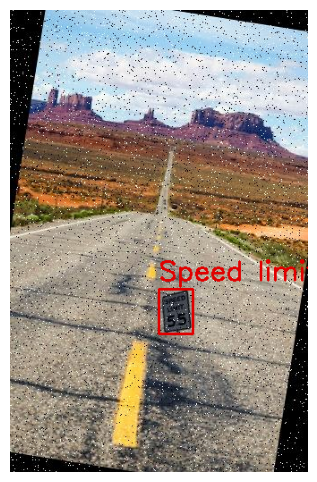


0: 384x640 1 Speed limit: 35, 116.3ms
Speed: 1.6ms preprocess, 116.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


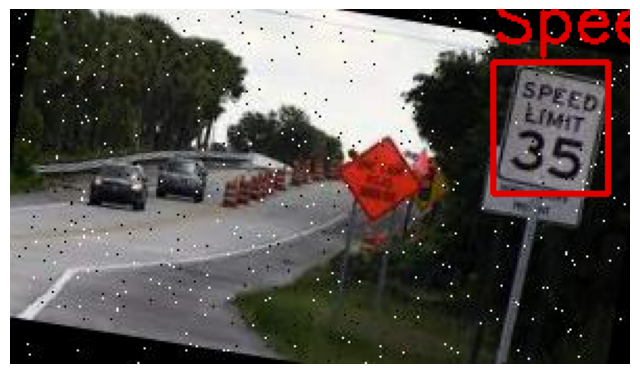


0: 384x640 1 Speed limit: 70, 10.6ms
Speed: 0.9ms preprocess, 10.6ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


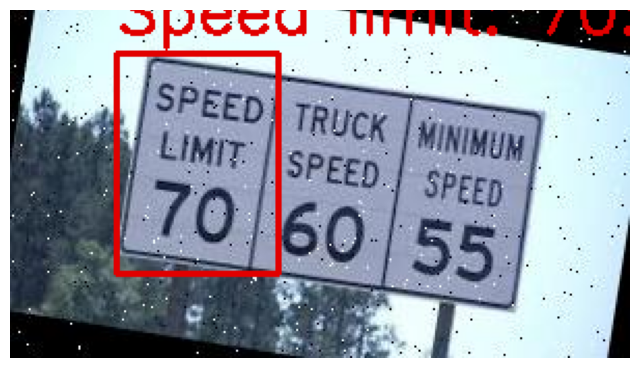


0: 640x640 1 Speed limit: 70, 13.0ms
Speed: 2.4ms preprocess, 13.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


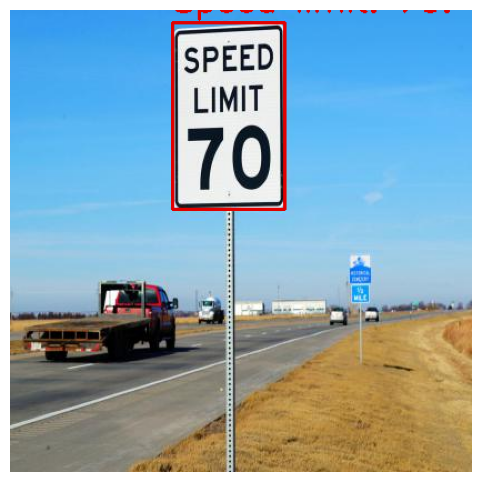


0: 480x640 2 Speed limit: 70s, 1 Speed limit: 40, 108.2ms
Speed: 1.0ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)


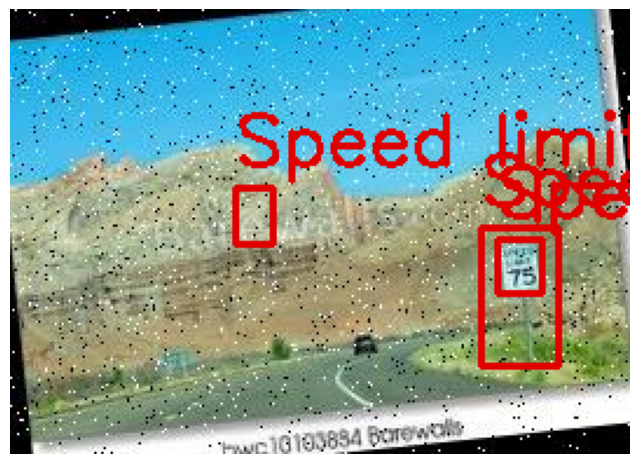


0: 480x640 1 Speed limit: 30, 10.3ms
Speed: 1.0ms preprocess, 10.3ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


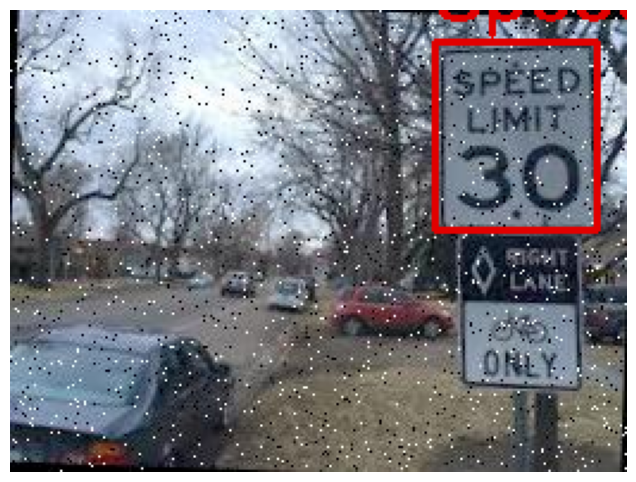


0: 640x544 1 Speed limit: 60, 107.5ms
Speed: 1.2ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 544)


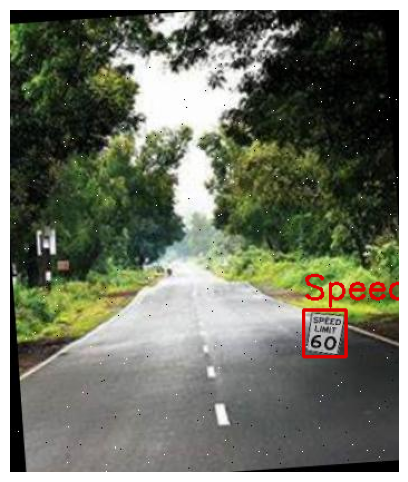


0: 384x640 1 Speed limit: 65, 11.2ms
Speed: 0.9ms preprocess, 11.2ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


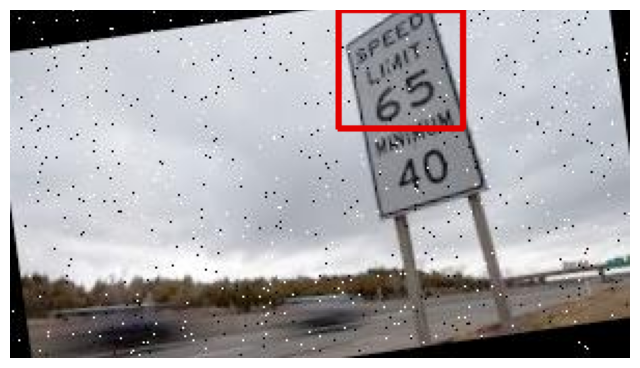

In [19]:
# Testing on test image
# test_dataset_dir = (
#     "/home/avalocal/Documents/yolov9_ros/src/yolov9ros/src/yolov9/cone_images"
# )
test_dataset_dir = "/media/avalocal/T9/harsha/datasets/speed_limit_data/test/images"
# Get the list of images in the test dataset directory
test_images = os.listdir(test_dataset_dir)

# model = YOLO(
#     '/home/avalocal/Documents/yolov9_ros/src/yolov9ros/src/yolov9/runs/detect/train6/weights/best.pt'
# )
model = YOLO(
    "/home/avalocal/Documents/yolov9_ros/src/yolov9ros/src/runs/detect/train3/weights/best.pt"
)

# for image_name in test_images[0, len(test_images), 100]:
print(model.names)
for img_id in range(0, len(test_images)):
    # Load the image
    image_path = os.path.join(test_dataset_dir, test_images[img_id])
    image = cv2.imread(image_path)
    image.shape
    detections = model(image)
    result = detections[0]
    class_id = result.boxes.cls.cpu().numpy()  # Class IDs
    confidence = result.boxes.conf.cpu().numpy()  # Confidence scores

    bboxes = np.array(result.boxes.xyxy.cpu(), dtype="int")  # Bounding boxes
    for i, bbox in enumerate(bboxes):
        (x, y, x2, y2) = bbox
        cv2.rectangle(image, (x, y), (x2, y2), (0, 0, 225), 2)
        # label = f"car: {float('{:.2f}'.format(confidence[i]))}"
        label = (
            f"{model.names[int(class_id[i])]}: {float('{:.2f}'.format(confidence[i]))}"
        )
        cv2.putText(
            image,
            label,
            (x, y - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            1,
            (0, 0, 225),
            2,
        )

    # Convert BGR to RGB for displaying with matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image with bounding boxes using matplotlib
    plt.figure(figsize=(8, 6))
    plt.imshow(image_rgb)
    plt.axis("off")
    plt.show()